In [2]:
# goal: re-write weighted RMSD in a way that makes it easy to take derivatives w.r.t. the weight vector, or use
# gradient-free approaches

In [3]:
import numpy.random as npr
import matplotlib.pyplot as plt
%matplotlib inline
from autograd import grad
import autograd.numpy as np

In [5]:
# random test data
n_atoms=10
X = np.random.randn(n_atoms,3)
Y = np.random.randn(n_atoms,3)

In [6]:
# Kabsch algorithm-- reference: https://github.com/charnley/rmsd/blob/master/calculate_rmsd

def rotate(X,Y):
    C = np.dot(X.T, Y)
    print(C.shape)
    _,U = np.linalg.eigh(np.dot(C,C.T))
    print(U.shape)
    _,V = np.linalg.eigh(np.dot(C.T,C))
    print(V.shape)
    if (np.linalg.det(U) * np.linalg.det(V)) < 0.0:
        U[:, -1] = -U[:, -1]
    return np.dot(U,V)

In [8]:
def rotate_w(X,Y,w=None):
    if w==None:
        w = np.ones(len(X))
    
    C = np.dot(np.dot(X.T, Y))
    _,U = np.linalg.eigh(np.dot(C,C.T))
    print(U.shape)
    _,V = np.linalg.eigh(np.dot(C.T,C))
    print(V.shape)
    if (np.linalg.det(U) * np.linalg.det(V)) < 0.0:
        U[:, -1] = -U[:, -1]
    return np.dot(U,V)

In [9]:
import MDAnalysis.analysis.rms as rms

In [10]:
X*np.ones((n_atoms,1))

array([[ 1.23321606, -0.57349706,  0.48108984],
       [-1.25667068, -1.17708466,  2.30454748],
       [ 1.09639381,  0.8065727 ,  0.99151013],
       [-2.12399993, -1.12349066, -0.47835083],
       [ 0.720556  ,  0.10691572, -0.40290627],
       [-0.86414012,  0.29752713,  1.2745237 ],
       [ 0.01465599,  0.60277358, -0.93499372],
       [ 0.27649253, -1.86095892, -0.15181492],
       [ 0.47782523, -1.14665809,  1.0439962 ],
       [-0.0814211 ,  0.82267558,  0.28624863]])

In [11]:
rotate(X,Y)

(3, 3)
(3, 3)
(3, 3)


array([[ 0.47392215,  0.82630685, -0.30432679],
       [-0.76556307,  0.21587137, -0.60606332],
       [-0.43509883,  0.52020818,  0.73489623]])

In [12]:
np.random.seed(0)
triplets = [(np.random.randn(n_atoms,3),np.random.randn(n_atoms,3),np.random.randn(n_atoms,3)) for i in range(10)]

In [13]:
from msmbuilder.example_datasets import AlanineDipeptide,FsPeptide
ala = AlanineDipeptide().get()
ala_traj = ala.trajectories[0]

In [18]:
from sklearn.decomposition import PCA
pca = PCA(n_components=2)
pca.fit(np.random.randn(100,10))
A = pca.components_.T
A.shape

(10, 2)

In [21]:
np.dot(A,A.T),np.dot(A.T,A)

(array([[ 0.20013632, -0.11239426, -0.03666427,  0.12992028,  0.01409279,
          0.08906593, -0.00135889, -0.27693143, -0.19834568, -0.07113744],
        [-0.11239426,  0.06348052,  0.00658745, -0.06591582,  0.00136479,
         -0.05259701,  0.00312518,  0.15736044,  0.11479567,  0.04137093],
        [-0.03666427,  0.00658745,  0.54957912, -0.29695827, -0.36231703,
          0.08365124, -0.0913232 , -0.02055903, -0.09574736, -0.04205603],
        [ 0.12992028, -0.06591582, -0.29695827,  0.22178614,  0.19015996,
          0.00751617,  0.04519511, -0.14389987, -0.06229608, -0.01846026],
        [ 0.01409279,  0.00136479, -0.36231703,  0.19015996,  0.23937594,
         -0.05997339,  0.06058586,  0.02774218,  0.07356033,  0.03149573],
        [ 0.08906593, -0.05259701,  0.08365124,  0.00751617, -0.05997339,
          0.0580457 , -0.0174677 , -0.13637014, -0.11259217, -0.04180249],
        [-0.00135889,  0.00312518, -0.0913232 ,  0.04519511,  0.06058586,
         -0.0174677 ,  0.0154559

In [24]:
np.sum(np.abs(np.dot(A.T,A) - np.eye(2)))

1.8630930131990908e-15

In [25]:
A.shape

(10, 2)

In [26]:
def orthonormal_columns_penalty(A):
    return np.sum(np.abs(np.dot(A.T,A) - np.eye(A.shape[1]))**2)

In [29]:
orthonormal_columns_penalty(pca.components_.T)

1.9759138449751608e-30

In [33]:
from msmbuilder.decomposition import tICA
tica = tICA(n_components=2)
tica.fit([np.random.randn(100,10)])
orthonormal_columns_penalty(tica.components_.T)

0.065268492774106665

In [47]:
comp = tica.components_.T# / tica.components_.mean(1)
comp.shape

(10, 2)

In [50]:
np.dot(comp.T,comp)-np.eye(2)

array([[ 0.15535957, -0.08263407],
       [-0.08263407,  0.1657562 ]])

In [45]:
orthonormal_columns_penalty(comp)

83166.28763124418

In [170]:
def tripletify_trajectory(X,tau_1=5,tau_2=20,xyz=True):
    X_triplets = []
    for i in range(len(X) - tau_2):
        if xyz:
            X_triplets.append((X[i].xyz[0],X[i+tau_1].xyz[0],X[i+tau_2].xyz[0]))
        else:
            X_triplets.append((X[i],X[i+tau_1],X[i+tau_2]))

    return X_triplets

In [177]:
ala_triplets = np.array(tripletify_trajectory(ala_traj,tau_1=5,tau_2=10),dtype=np.float64)

In [231]:
def cheap_triplet_batch(triplets=ala_triplets,batch_size=10):
    return triplets[np.random.randint(0,len(triplets),batch_size)]

In [1]:
def likelihood(weights,generate_triplets=cheap_triplet_batch,d=rms.rmsd):
    triplets = generate_triplets()
    return -np.sum(np.nan_to_num([d(t[0],t[1],weights) - d(t[0],t[2],weights) for t in triplets]))

def prior(weights):
    if sum(weights < 0):
        # don't accept weight vectors with any negative elements
        return -np.inf
    return 0
    #return -np.sum(weights**2)

def prob(weights,penalty_param=0.05,d=rms.rmsd):
    return likelihood(weights,d=d)+penalty_param*prior(weights)

NameError: name 'cheap_triplet_batch' is not defined

In [280]:
likelihood(np.ones(n_atoms))
prior(np.ones(n_atoms))

0

In [281]:
likelihood(np.ones(n_atoms)),prior(np.ones(n_atoms))

(0.2994766470086041, 0)

In [282]:
likelihood(np.ones(n_atoms)),likelihood(np.random.randn(n_atoms))

(0.36499266226774524, 0.87451959764752374)

In [283]:
-np.inf

-inf

In [284]:
def RMSD(X,Y):
    # compute optimal rotation of X onto Y using SVD
    
    # compute atomwise deviations
    return

In [285]:
%timeit likelihood(np.random.randn(n_atoms))

1000 loops, best of 3: 671 µs per loop


In [286]:
n_atoms=len(ala_triplets[0][0])
n_atoms

22

In [308]:
len(p0*2)

88

In [ ]:
import emcee

ndim, nwalkers = n_atoms, n_atoms*2
#p0 = [np.random.rand(ndim) for i in range(nwalkers)]

#sampler = emcee.EnsembleSampler(nwalkers, ndim, prob)
ntemps=10
sampler = emcee.PTSampler(ntemps,nwalkers,ndim,likelihood,prior)
p0 = np.random.rand(ntemps, nwalkers, ndim)
sample_results = sampler.run_mcmc(p0, 1000)

/Users/joshuafass/anaconda/envs/py27/lib/python2.7/site-packages/emcee/ptsampler.py:278: DeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
  self.dim))
/Users/joshuafass/anaconda/envs/py27/lib/python2.7/site-packages/emcee/ptsampler.py:279: DeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
  self._lnprob = np.zeros((self.ntemps, self.nwalkers, nsave))
/Users/joshuafass/anaconda/envs/py27/lib/python2.7/site-packages/emcee/ptsampler.py:281: DeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
  nsave))
/Users/joshuafass/anaconda/envs/py27/lib/python2.7/site-packages/emcee/ptsampler.py:308: DeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
  zs = np.exp(np.random.uniform(low=-np.log(self.a), high=np.log(self.a), size=(self.ntemps, self.nwalkers/2)))
/Users/joshuafass/

In [320]:
sampler.flatchain.mean(0).shape

(4400, 22)

In [321]:
sampler.flatchain.shape

(6, 4400, 22)

In [328]:
samples = sampler.flatchain[0,:]
samples = (samples.T / samples.sum(1)).T
samples.shape

(4400, 22)

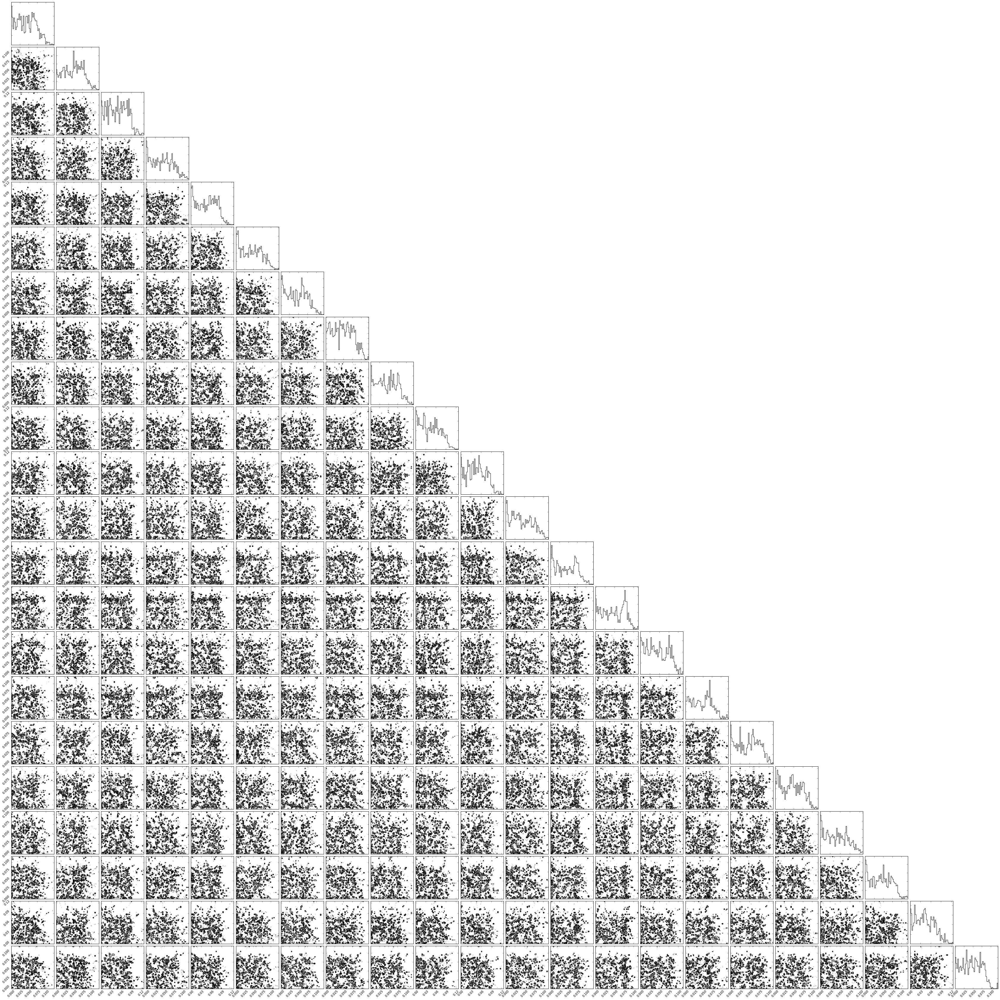

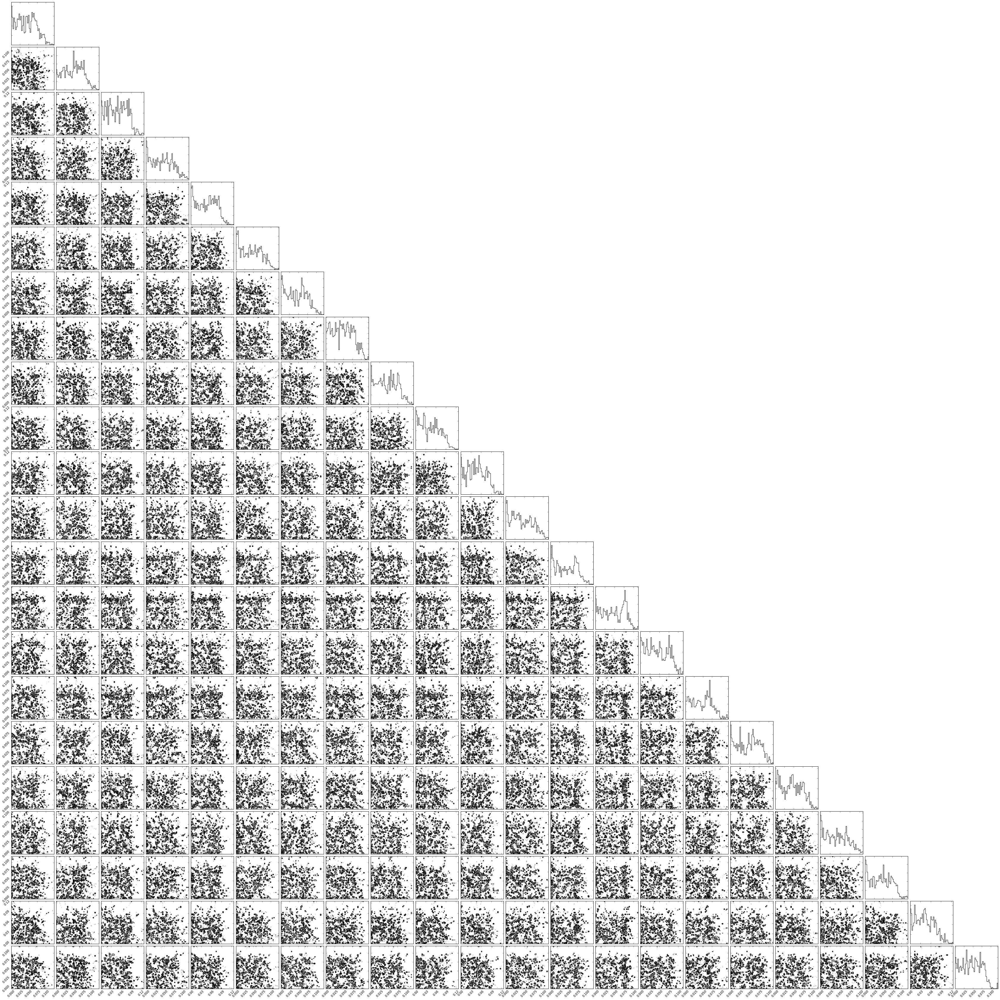

In [330]:
triangle.corner(samples)

In [319]:
sampler.acceptance_fraction

array([[ 0.11,  0.09,  0.05,  0.11,  0.04,  0.1 ,  0.12,  0.13,  0.07,
         0.06,  0.06,  0.08,  0.05,  0.06,  0.04,  0.06,  0.07,  0.06,
         0.08,  0.04,  0.08,  0.05,  0.06,  0.06,  0.09,  0.1 ,  0.11,
         0.08,  0.09,  0.06,  0.06,  0.09,  0.02,  0.07,  0.09,  0.05,
         0.07,  0.07,  0.08,  0.07,  0.09,  0.06,  0.07,  0.09],
       [ 0.06,  0.08,  0.03,  0.12,  0.04,  0.06,  0.06,  0.11,  0.02,
         0.08,  0.09,  0.07,  0.06,  0.12,  0.09,  0.08,  0.07,  0.03,
         0.09,  0.09,  0.05,  0.07,  0.11,  0.06,  0.07,  0.04,  0.09,
         0.09,  0.07,  0.05,  0.09,  0.07,  0.05,  0.07,  0.12,  0.11,
         0.04,  0.11,  0.06,  0.06,  0.12,  0.06,  0.07,  0.06],
       [ 0.03,  0.09,  0.06,  0.12,  0.07,  0.08,  0.09,  0.06,  0.07,
         0.08,  0.05,  0.07,  0.09,  0.11,  0.08,  0.12,  0.11,  0.08,
         0.06,  0.08,  0.06,  0.06,  0.08,  0.08,  0.06,  0.1 ,  0.06,
         0.05,  0.07,  0.07,  0.1 ,  0.06,  0.08,  0.11,  0.07,  0.12,
         0.06,  0.

In [290]:
sample_results[0].shape

(44, 22)

In [291]:
sampler.flatchain.shape

(4400, 22)

In [292]:
samples = sampler.flatchain / sampler.flatchain.mean(0)

In [293]:
sampler.flatchain.mean(0).shape

(22,)

In [294]:
import triangle

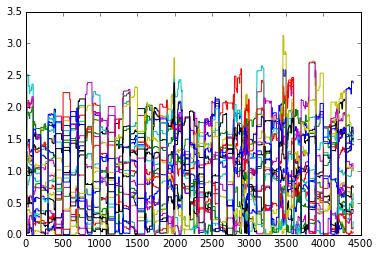

In [295]:
plt.plot(samples);

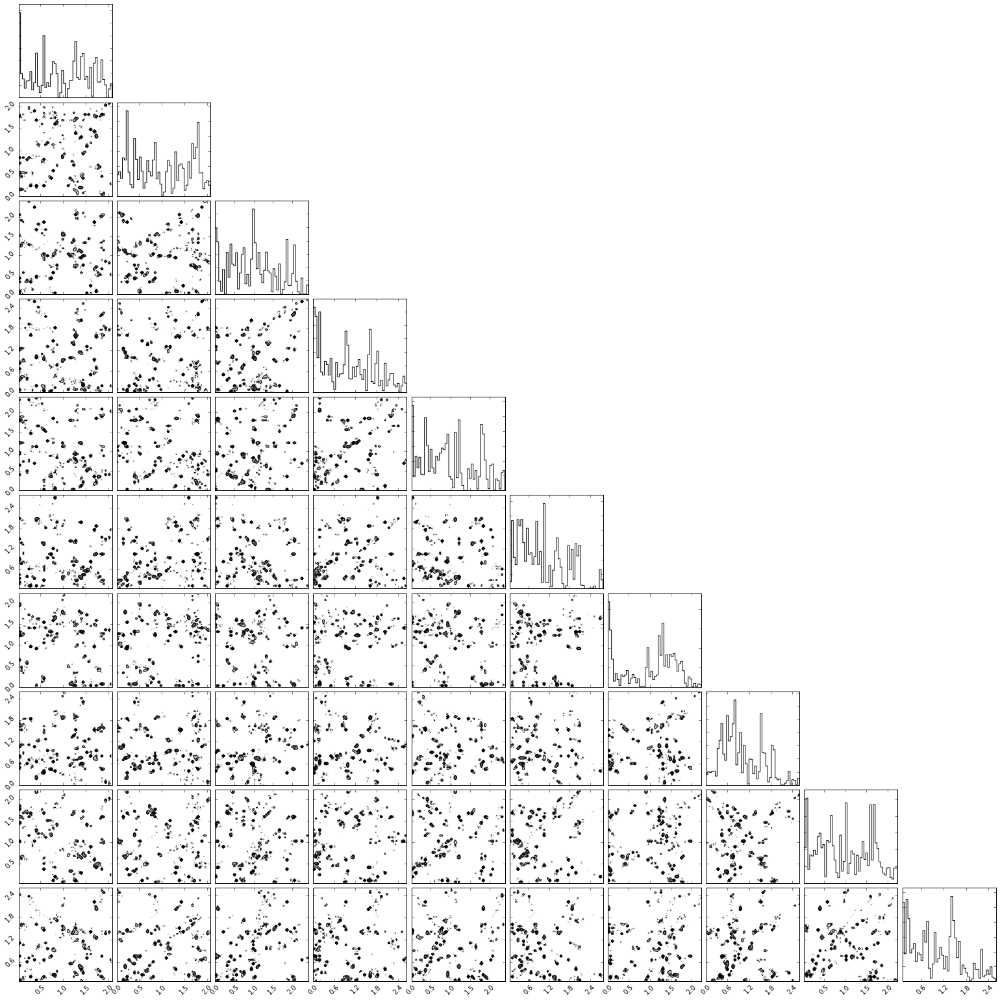

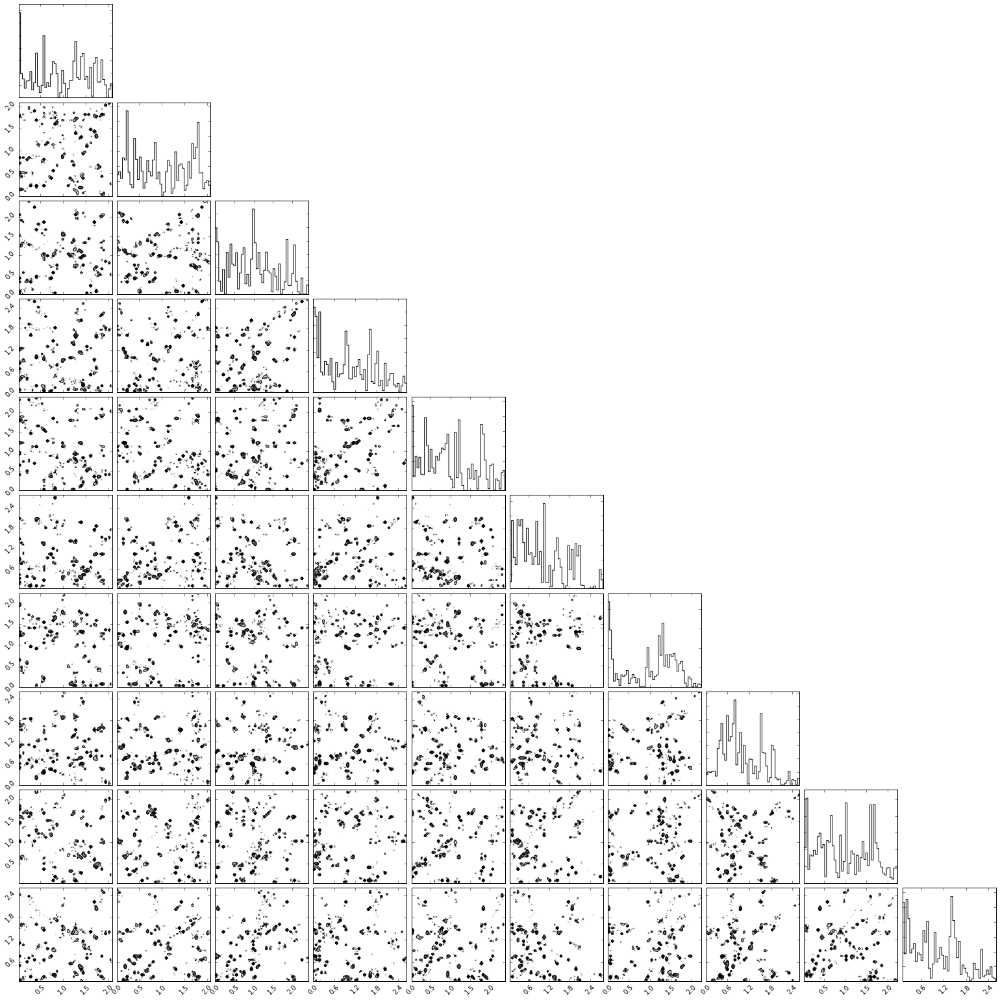

In [296]:
triangle.corner(samples[:,:10])

In [297]:
sampler.acceptance_fraction

array([ 0.08,  0.05,  0.04,  0.08,  0.01,  0.02,  0.06,  0.03,  0.06,
        0.04,  0.09,  0.02,  0.07,  0.08,  0.08,  0.  ,  0.09,  0.09,
        0.04,  0.13,  0.11,  0.05,  0.07,  0.05,  0.11,  0.07,  0.05,
        0.1 ,  0.09,  0.17,  0.08,  0.04,  0.05,  0.06,  0.15,  0.15,
        0.1 ,  0.09,  0.09,  0.05,  0.04,  0.07,  0.14,  0.1 ])

In [299]:
samples.mean(0),sampler.flatchain.mean(0)

(array([ 1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,
         1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.]),
 array([ 0.50389738,  0.5045156 ,  0.49157817,  0.42978294,  0.43417005,
         0.45080779,  0.5562616 ,  0.49162303,  0.5242842 ,  0.44106989,
         0.51980393,  0.4545413 ,  0.5462859 ,  0.50222424,  0.54089176,
         0.56620906,  0.55488015,  0.54840427,  0.54718733,  0.48220203,
         0.5698671 ,  0.50844573]))

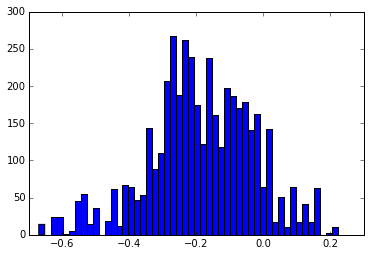

In [277]:
plt.hist(sampler.flatlnprobability,bins=50);